# Elections Data Analysis

## Data Cleaning

### **1. Importing Libraries**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sb
import plotly.express as px
import geopandas as gpd

### **2. Reading 2014 data**

In [2]:
ls_2014 = pd.read_csv("F:\Python\Task\Codebasics Task\P 11 Elections\constituency_wise_results_2014.csv")
ls_2014.head(10)

,state,pc_name,candidate,sex,age,category,party,party_symbol,general_votes,postal_votes,total_votes,total_electors
0,Andhra Pradesh,Adilabad,GODAM NAGESH,M,49.0,ST,TRS,Car,425762,5085,430847,1386282
1,Andhra Pradesh,Adilabad,NARESH,M,37.0,ST,INC,Hand,257994,1563,259557,1386282
2,Andhra Pradesh,Adilabad,RAMESH RATHOD,M,48.0,ST,TDP,Bicycle,182879,1319,184198,1386282
3,Andhra Pradesh,Adilabad,RATHOD SADASHIV,M,55.0,ST,BSP,Elephant,94363,57,94420,1386282
4,Andhra Pradesh,Adilabad,NETHAWATH RAMDAS,M,44.0,ST,IND,Auto- Rickshaw,41028,4,41032,1386282
5,Andhra Pradesh,Adilabad,PAWAR KRISHNA,M,33.0,ST,IND,Bat,5051,4,5055,1386282
6,Andhra Pradesh,Adilabad,BANKA SAHADEV,M,53.0,ST,IND,Gas Cylinder,4780,7,4787,1386282
7,Andhra Pradesh,Adilabad,MOSALI CHINNAIAH,M,40.0,ST,IND,Almirah,8842,17,8859,1386282
8,Andhra Pradesh,Adilabad,None of the Above,NaN,NaN,NaN,NOTA,NOTA,17021,63,17084,1386282
9,Andhra Pradesh,Peddapalle,DR.JANAPATI SARAT BABU,M,42.0,SC,TDP,Bicycle,63174,160,63334,1425355


### **3. Reading 2019 data**

In [3]:
ls_2019 = pd.read_csv("F:\Python\Task\Codebasics Task\P 11 Elections\constituency_wise_results_2019.csv")
ls_2019.head(10)

,state,pc_name,candidate,sex,age,category,party,party_symbol,general_votes,postal_votes,total_votes,total_electors
0,Andhra Pradesh,Aruku,KISHORE CHANDRA DEO,MALE,72.0,ST,TDP,Bicycle,336163,1938,338101,1451418
1,Andhra Pradesh,Aruku,Dr. KOSURI KASI VISWANADHA VEERA VENKATA SATYA...,MALE,54.0,ST,BJP,Lotus,17578,289,17867,1451418
2,Andhra Pradesh,Aruku,GODDETI. MADHAVI,FEMALE,26.0,ST,YSRCP,Ceiling Fan,557561,4629,562190,1451418
3,Andhra Pradesh,Aruku,SHRUTI DEVI VYRICHERLA,FEMALE,46.0,ST,INC,Hand,17656,74,17730,1451418
4,Andhra Pradesh,Aruku,GANGULAIAH VAMPURU.,MALE,49.0,ST,JnP,Glass Tumbler,42245,549,42794,1451418
5,Andhra Pradesh,Aruku,SWAMULA. SUBRAHMANYAM,MALE,50.0,ST,JAJGP,Mike,4705,5,4710,1451418
6,Andhra Pradesh,Aruku,ANUMULA VAMSIKRISHNA,MALE,41.0,ST,IND,Helicopter,10211,29,10240,1451418
7,Andhra Pradesh,Aruku,KANGALA BALUDORA,MALE,61.0,ST,IND,Cup & Saucer,13810,16,13826,1451418
8,Andhra Pradesh,Aruku,NARAVA SATYAVATHI,FEMALE,37.0,ST,IND,Bangles,11231,5,11236,1451418
9,Andhra Pradesh,Aruku,BIDDIKA RAMAYYA.,MALE,57.0,ST,IND,Battery Torch,7863,4,7867,1451418


### **4. Reading dim_state_codes**

In [4]:
ls_sc = pd.read_csv("F:\Python\Task\Codebasics Task\P 11 Elections\dim_states_codes.csv")
ls_sc.head(10)

,state_name,abbreviation
0,Andaman & Nicobar Islands,AN
1,Andhra Pradesh,AP
2,Arunachal Pradesh,AR
3,Assam,AS
4,Bihar,BR
5,Chandigarh,CH
6,Chhattisgarh,CT
7,Dadra & Nagar Haveli,DN
8,Daman & Diu,DD
9,NCT OF Delhi,DL


In [5]:
# renaming state_name to state to match it with other df
ls_sc.rename(columns = {'state_name':'state'}, inplace=True)
ls_sc.head(10)

,state,abbreviation
0,Andaman & Nicobar Islands,AN
1,Andhra Pradesh,AP
2,Arunachal Pradesh,AR
3,Assam,AS
4,Bihar,BR
5,Chandigarh,CH
6,Chhattisgarh,CT
7,Dadra & Nagar Haveli,DN
8,Daman & Diu,DD
9,NCT OF Delhi,DL


### **5. Looking into DataTypes & Null Values of 2014 & 2019 columns**

In [6]:
ls_2014.info() #null values in sex & age are for NOTA

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8355 entries, 0 to 8354
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   state           8355 non-null   object 
 1   pc_name         8355 non-null   object 
 2   candidate       8355 non-null   object 
 3   sex             7845 non-null   object 
 4   age             7845 non-null   float64
 5   category        7845 non-null   object 
 6   party           8355 non-null   object 
 7   party_symbol    8355 non-null   object 
 8   general_votes   8355 non-null   int64  
 9   postal_votes    8355 non-null   int64  
 10  total_votes     8355 non-null   int64  
 11  total_electors  8355 non-null   int64  
dtypes: float64(1), int64(4), object(7)
memory usage: 783.4+ KB


In [7]:
ls_2019.info() #null values in sex & age are for NOTA

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8597 entries, 0 to 8596
Data columns (total 12 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   state           8597 non-null   object 
 1   pc_name         8597 non-null   object 
 2   candidate       8597 non-null   object 
 3   sex             8054 non-null   object 
 4   age             8054 non-null   float64
 5   category        8054 non-null   object 
 6   party           8597 non-null   object 
 7   party_symbol    8054 non-null   object 
 8   general_votes   8597 non-null   int64  
 9   postal_votes    8597 non-null   int64  
 10  total_votes     8597 non-null   int64  
 11  total_electors  8597 non-null   int64  
dtypes: float64(1), int64(4), object(7)
memory usage: 806.1+ KB


### **6. Getting Unique Values**

In [8]:
ls_2014['state'].nunique() # returns the number of unique values in the 'state' column
ls_2014['state'].unique() # returns an array of all the unique values in the 'state' column

array(['Andhra Pradesh', 'Arunachal Pradesh', 'Assam', 'Bihar', 'Goa',
       'Gujarat', 'Haryana', 'Himachal Pradesh', 'Jammu & Kashmir',
       'Karnataka', 'Kerala', 'Madhya Pradesh', 'Maharashtra', 'Manipur',
       'Meghalaya', 'Mizoram', 'Nagaland', 'Punjab', 'Rajasthan',
       'Sikkim', 'Tamil Nadu', 'Tripura', 'Uttar Pradesh', 'West Bengal',
       'Jharkhand', 'Uttarakhand', 'Andaman & Nicobar Islands',
       'Chandigarh', 'Dadra & Nagar Haveli', 'Daman & Diu',
       'NCT OF Delhi', 'Lakshadweep', 'Puducherry'], dtype=object)

In [9]:
ls_2019['state'].nunique() # returns the number of unique values in the 'state' column
ls_2019['state'].unique() # returns an array of all the unique values in the 'state' column

array(['Andhra Pradesh', 'Arunachal Pradesh', 'Assam', 'Bihar', 'Goa',
       'Gujarat', 'Haryana', 'Himachal Pradesh', 'Jammu & Kashmir',
       'Karnataka', 'Kerala', 'Madhya Pradesh', 'Maharashtra', 'Manipur',
       'Meghalaya', 'Mizoram', 'Nagaland', 'Odisha', 'Punjab',
       'Rajasthan', 'Sikkim', 'Tamil Nadu', 'Tripura', 'Uttar Pradesh',
       'West Bengal', 'Chhattisgarh', 'Jharkhand', 'Uttarakhand',
       'Telangana', 'Andaman & Nicobar Islands', 'Chandigarh',
       'Dadra & Nagar Haveli', 'Daman & Diu', 'NCT OF Delhi',
       'Lakshadweep', 'Puducherry'], dtype=object)

State of AP gets bifurcation in 2014 and Telangana is formed.

### **7. Replacing state name for Telengana constituencies in df_2014**

In [10]:
# getting constituencies that got seperated in 2014 from AP
ls_2019[ls_2019['state']=='Telangana']['pc_name'].unique()

array(['Adilabad ', 'Peddapalle ', 'Karimnagar ', 'Nizamabad',
       'Zahirabad', 'Medak', 'Malkajgiri', 'Secundrabad', 'Hyderabad',
       'CHEVELLA', 'Mahbubnagar', 'Nagarkurnool', 'Nalgonda', 'Bhongir ',
       'Warangal', 'Mahabubabad  ', 'Khammam '], dtype=object)

In [11]:
telangana_pc_names = ['Adilabad ', 'Peddapalle ', 'Karimnagar ', 'Nizamabad',
       'Zahirabad', 'Medak', 'Malkajgiri', 'Secundrabad', 'Hyderabad',
       'CHEVELLA', 'Mahbubnagar', 'Nagarkurnool', 'Nalgonda', 'Bhongir ',
       'Warangal', 'Mahabubabad  ', 'Khammam ']

In [12]:
# Update the 'state' column to 'Telangana' for rows where the 'pc_name' is in the list telangana_pc_names
ls_2014.loc[
    # Check if the 'pc_name' value is in the list telangana_pc_names
    ls_2014['pc_name'].isin(telangana_pc_names), 
    # Specify the column to be updated
    'state'
] = 'Telangana'  # Set the 'state' column value to 'Telangana'
ls_2014['state'].unique()

array(['Telangana', 'Andhra Pradesh', 'Arunachal Pradesh', 'Assam',
       'Bihar', 'Goa', 'Gujarat', 'Haryana', 'Himachal Pradesh',
       'Jammu & Kashmir', 'Karnataka', 'Kerala', 'Madhya Pradesh',
       'Maharashtra', 'Manipur', 'Meghalaya', 'Mizoram', 'Nagaland',
       'Punjab', 'Rajasthan', 'Sikkim', 'Tamil Nadu', 'Tripura',
       'Uttar Pradesh', 'West Bengal', 'Jharkhand', 'Uttarakhand',
       'Andaman & Nicobar Islands', 'Chandigarh', 'Dadra & Nagar Haveli',
       'Daman & Diu', 'NCT OF Delhi', 'Lakshadweep', 'Puducherry'],
      dtype=object)

In [13]:
ls_2014['state'].nunique()
#telangana has been added

34

#### **8. Replacing consituencies name**

Few states have same constituency names. So replacing constituency name followed by the respective state name to differentiate

In [14]:
# Group the DataFrame ls_2014 by 'pc_name' and calculate the size of each group
counts = ls_2014.groupby('pc_name').size()
# 'counts' will be a Series with the number of occurrences for each 'pc_name'

In [15]:
# Print all unique values in the 'pc_name' column of the DataFrame
print(ls_2014['pc_name'].unique())

# Print the keys of the counts Series
print(counts.index)


['Adilabad ' 'Peddapalle ' 'Karimnagar ' 'Nizamabad' 'Zahirabad' 'Medak'
 'Malkajgiri' 'Secundrabad' 'Hyderabad' 'CHELVELLA' 'Mahbubnagar'
 'Nagarkurnool' 'Nalgonda' 'Bhongir ' 'Warangal' 'Mahabubabad  '
 'Khammam ' 'Aruku ' 'Srikakulam' 'Vizianagaram' 'Visakhapatnam'
 'Anakapalli' 'Kakinada' 'Amalapuram ' 'Rajahmundry' 'Narsapuram' 'Eluru '
 'Machilipatnam ' 'Vijayawada' 'Guntur' 'Narasaraopet' 'Bapatla '
 'Ongole ' 'Nandyal' 'Kurnool' 'Anantapur' 'Hindupur' 'Kadapa' 'Nellore'
 'Tirupati ' 'Rajampet' 'Chittoor ' 'ARUNACHAL WEST' 'ARUNACHAL EAST'
 'Karimganj ' 'Silchar' 'Autonomous District' 'Dhubri' 'Kokrajhar'
 'Barpeta' 'Gauhati' 'Mangaldoi' 'Tezpur' 'Nowgong' 'Kaliabor' 'Jorhat'
 'Dibrugarh' 'Lakhimpur' 'Valmiki Nagar' 'Paschim Champaran'
 'Purvi Champaran' 'Sheohar' 'Sitamarhi' 'Madhubani' 'Jhanjharpur'
 'Supaul' 'Araria' 'Kishanganj' 'Katihar' 'Purnia' 'Madhepura' 'Darbhanga'
 'Muzaffarpur' 'Vaishali' 'Gopalganj (SC)' 'Siwan' 'Maharajganj' 'Saran'
 'Hajipur (SC)' 'Ujiarpur' 'Sama

In [16]:
for index, row in ls_2014.iterrows():
    # Check if the 'pc_name' is in the counts Series to avoid KeyError
    if row['pc_name'] in counts and counts[row['pc_name']] > 1:
        ls_2014.at[index, 'pc_name'] = f"{row['pc_name']}_{row['state']}"


In [17]:
countb = ls_2019.groupby('pc_name').size()

In [18]:
# Iterate over each row in the DataFrame df_2019
for index, row in ls_2019.iterrows():
    # Check if the count of the current 'pc_name' is greater than 1 (i.e., there are duplicates)
    if countb[row['pc_name']] > 1:
        # Update the 'pc_name' to a unique value by appending the 'state'
        ls_2019.at[index, 'pc_name'] = f"{row['pc_name']}_{row['state']}"

In [19]:
ls_2019.head(10)

,state,pc_name,candidate,sex,age,category,party,party_symbol,general_votes,postal_votes,total_votes,total_electors
0,Andhra Pradesh,Aruku _Andhra Pradesh,KISHORE CHANDRA DEO,MALE,72.0,ST,TDP,Bicycle,336163,1938,338101,1451418
1,Andhra Pradesh,Aruku _Andhra Pradesh,Dr. KOSURI KASI VISWANADHA VEERA VENKATA SATYA...,MALE,54.0,ST,BJP,Lotus,17578,289,17867,1451418
2,Andhra Pradesh,Aruku _Andhra Pradesh,GODDETI. MADHAVI,FEMALE,26.0,ST,YSRCP,Ceiling Fan,557561,4629,562190,1451418
3,Andhra Pradesh,Aruku _Andhra Pradesh,SHRUTI DEVI VYRICHERLA,FEMALE,46.0,ST,INC,Hand,17656,74,17730,1451418
4,Andhra Pradesh,Aruku _Andhra Pradesh,GANGULAIAH VAMPURU.,MALE,49.0,ST,JnP,Glass Tumbler,42245,549,42794,1451418
5,Andhra Pradesh,Aruku _Andhra Pradesh,SWAMULA. SUBRAHMANYAM,MALE,50.0,ST,JAJGP,Mike,4705,5,4710,1451418
6,Andhra Pradesh,Aruku _Andhra Pradesh,ANUMULA VAMSIKRISHNA,MALE,41.0,ST,IND,Helicopter,10211,29,10240,1451418
7,Andhra Pradesh,Aruku _Andhra Pradesh,KANGALA BALUDORA,MALE,61.0,ST,IND,Cup & Saucer,13810,16,13826,1451418
8,Andhra Pradesh,Aruku _Andhra Pradesh,NARAVA SATYAVATHI,FEMALE,37.0,ST,IND,Bangles,11231,5,11236,1451418
9,Andhra Pradesh,Aruku _Andhra Pradesh,BIDDIKA RAMAYYA.,MALE,57.0,ST,IND,Battery Torch,7863,4,7867,1451418


#### **9. Obtaining the descriptive statistics for the dataframe**

In [20]:
ls_2014.describe()

,age,general_votes,postal_votes,total_votes,total_electors
count,7845.000000,8355.000000,8355.000000,8355.000000,8.355000e+03
mean,47.135883,62132.985398,107.407660,62240.393058,1.574132e+06
std,11.902487,140261.650370,436.090305,140535.827087,2.711797e+05
min,25.000000,105.000000,0.000000,105.000000,4.992200e+04
25%,38.000000,1708.000000,0.000000,1708.500000,1.446478e+06
50%,46.000000,4350.000000,1.000000,4354.000000,1.578125e+06
75%,56.000000,14881.000000,13.000000,14886.000000,1.718414e+06
max,93.000000,859973.000000,6792.000000,863358.000000,3.183083e+06


In [21]:
ls_2019.describe()

,age,general_votes,postal_votes,total_votes,total_electors
count,8054.000000,8.597000e+03,8597.000000,8.597000e+03,8.597000e+03
mean,47.065185,7.117290e+04,267.469699,7.144037e+04,1.705181e+06
std,12.140434,1.735669e+05,929.319680,1.742342e+05,2.969405e+05
min,24.000000,8.400000e+01,0.000000,8.400000e+01,5.518900e+04
25%,38.000000,1.315000e+03,1.000000,1.317000e+03,1.553385e+06
50%,46.000000,3.341000e+03,4.000000,3.350000e+03,1.703279e+06
75%,56.000000,1.239100e+04,36.000000,1.242100e+04,1.856791e+06
max,90.000000,1.066824e+06,19367.000000,1.068569e+06,3.150313e+06


# **Data Analysis & Visualisation**

#### **1. List top 5/bottom 5 constituencies of 2014 and 2019 in terms of voter turnout ratio**

##### **2014**

In [22]:
# Group by 'pc_name' and calculate the sum of 'total_votes' for each group
total_votes_sum = ls_2014.groupby('pc_name')['total_votes'].sum()

# Group by 'pc_name' and calculate the maximum 'total_electors' for each group
total_electors_max = ls_2014.groupby('pc_name')['total_electors'].max()

# Calculate the voter turnout ratio as a percentage and round it to 2 decimal places
voter_turnout_ratio_2014 = round((total_votes_sum / total_electors_max) * 100, 2)

# Output the voter turnout ratio
voter_turnout_ratio_2014

pc_name
ARUNACHAL EAST_Arunachal Pradesh    83.56
ARUNACHAL WEST_Arunachal Pradesh    75.15
Adilabad _Telangana                 75.44
Agra_Uttar Pradesh                  58.98
Ahmadnagar _Maharashtra             62.31
                                    ...  
Warangal_Telangana                  76.38
Wardha_Maharashtra                  64.78
Wayanad_Kerala                      73.23
Yavatmal-Washim_Maharashtra         58.85
Zahirabad_Telangana                 75.75
Length: 511, dtype: float64

In [23]:
# Top 5 constituencies by voter turnout ratio in 2014

# Sort the voter turnout ratios in descending order
voter_turnout_ratio_2014_desc = voter_turnout_ratio_2014.sort_values(ascending=False)

# Get the top 5 constituencies with the highest voter turnout ratios
top5_constituencies14 = voter_turnout_ratio_2014_desc.head(5)

# Output the top 5 constituencies
top5_constituencies14

pc_name
Dhubri_Assam               88.35
Nagaland_Nagaland          87.82
Tamluk_West Bengal         87.59
Bishnupur_West Bengal      86.72
Lakshadweep_Lakshadweep    86.61
dtype: float64

In [24]:
# Bottom 5 constituencies by voter turnout ratio in 2014

# Sort the voter turnout ratios in ascending order
voter_turnout_ratio_2014_asc = voter_turnout_ratio_2014.sort_values()

# Get the bottom 5 constituencies with the lowest voter turnout ratios
bottom5_constituencies14 = voter_turnout_ratio_2014_asc.head(5)

# Output the bottom 5 constituencies
bottom5_constituencies14

pc_name
Srinagar_Jammu & Kashmir     25.86
Anantnag_Jammu & Kashmir     28.84
Baramulla_Jammu & Kashmir    39.13
Kalyan_Maharashtra           42.88
Patna Sahib_Bihar            45.33
dtype: float64

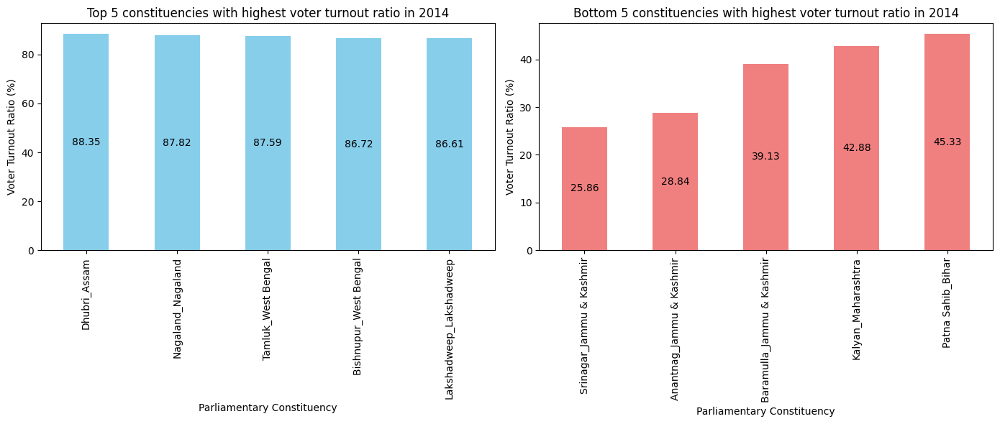

In [25]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Plot the top 5 constituencies' voter turnout ratio as a bar chart on the first subplot (left)
top5_constituencies14.plot(kind='bar', ax=axes[0], color='skyblue')
axes[0].set_title('Top 5 constituencies with highest voter turnout ratio in 2014')
axes[0].set_xlabel('Parliamentary Constituency')
axes[0].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the first subplot
for i in axes[0].containers:
    axes[0].bar_label(i, label_type='center')

# Plot the bottom 5 constituencies' voter turnout ratio as a bar chart on the second subplot (right)
bottom5_constituencies14.plot(kind='bar', ax=axes[1], color='lightcoral')
axes[1].set_title('Bottom 5 constituencies with highest voter turnout ratio in 2014')
axes[1].set_xlabel('Parliamentary Constituency')
axes[1].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the second subplot
for i in axes[1].containers:
    axes[1].bar_label(i, label_type='center')

# Adjust the layout to prevent overlapping elements
plt.tight_layout()

# Display the plot
plt.show()


##### **2019**

In [26]:
# Group by 'pc_name' and calculate the sum of 'total_votes' for each group
total_votes_sum = ls_2019.groupby('pc_name')['total_votes'].sum()

# Group by 'pc_name' and calculate the maximum 'total_electors' for each group
total_electors_max = ls_2019.groupby('pc_name')['total_electors'].max()

# Calculate the voter turnout ratio as a percentage and round it to 2 decimal places
voter_turnout_ratio_2019 = round((total_votes_sum / total_electors_max) * 100, 2)

# Output the voter turnout ratio
voter_turnout_ratio_2019

pc_name
ARUNACHAL EAST_Arunachal Pradesh    86.46
ARUNACHAL WEST_Arunachal Pradesh    77.26
Adilabad _Telangana                 71.40
Agra_Uttar Pradesh                  59.11
Ahmadnagar _Maharashtra             64.67
                                    ...  
Warangal_Telangana                  63.69
Wardha_Maharashtra                  61.53
Wayanad_Kerala                      80.33
Yavatmal-Washim_Maharashtra         61.28
Zahirabad_Telangana                 69.69
Length: 543, dtype: float64

In [27]:
# Top 5 constituencies by voter turnout ratio in 2019

# Sort the voter turnout ratios in descending order
voter_turnout_ratio_2019_desc = voter_turnout_ratio_2019.sort_values(ascending=False)

# Get the top 5 constituencies with the highest voter turnout ratios
top5_constituencies19 = voter_turnout_ratio_2019_desc.head(5)

# Output the top 5 constituencies
top5_constituencies19

pc_name
Dhubri_Assam                        90.66
Bishnupur_West Bengal               87.31
Barpeta_Assam                       86.55
Jalpaiguri_West Bengal              86.49
ARUNACHAL EAST_Arunachal Pradesh    86.46
dtype: float64

In [28]:
# Bottom 5 constituencies by voter turnout ratio in 2019

# Sort the voter turnout ratios in ascending order
voter_turnout_ratio_2019_asc = voter_turnout_ratio_2019.sort_values()

# Get the bottom 5 constituencies with the lowest voter turnout ratios
bottom5_constituencies19 = voter_turnout_ratio_2019_asc.head(5)

# Output the bottom 5 constituencies
bottom5_constituencies19

pc_name
Anantnag_Jammu & Kashmir      8.94
Srinagar_Jammu & Kashmir     14.43
Baramulla_Jammu & Kashmir    34.57
Hyderabad_Telangana          44.84
Kalyan_Maharashtra           45.29
dtype: float64

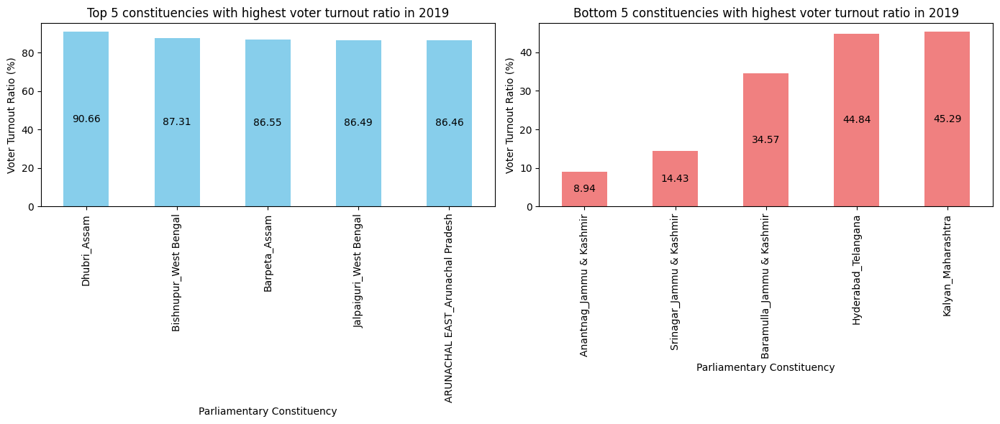

In [29]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Plot the top 5 constituencies' voter turnout ratio as a bar chart on the first subplot (left)
top5_constituencies19.plot(kind='bar', ax=axes[0], color='skyblue')
axes[0].set_title('Top 5 constituencies with highest voter turnout ratio in 2019')
axes[0].set_xlabel('Parliamentary Constituency')
axes[0].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the first subplot
for i in axes[0].containers:
    axes[0].bar_label(i, label_type='center')

# Plot the bottom 5 constituencies' voter turnout ratio as a bar chart on the second subplot (right)
bottom5_constituencies19.plot(kind='bar', ax=axes[1], color='lightcoral')
axes[1].set_title('Bottom 5 constituencies with highest voter turnout ratio in 2019')
axes[1].set_xlabel('Parliamentary Constituency')
axes[1].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the second subplot
for i in axes[1].containers:
    axes[1].bar_label(i, label_type='center')

# Adjust the layout to prevent overlapping elements
plt.tight_layout()

# Display the plot
plt.show()

#### **2. List top 5/bottom 5 states of 2014 and 2019 in terms of voter turnout ratio**

##### **2014**

In [30]:
#getting unique totalelectors per pc_name
unique_ls_2014 = ls_2014.drop_duplicates(subset=['pc_name'])

#getting totalelectors per state
total_electors_state14 = unique_ls_2014.groupby('state')['total_electors'].sum()

#getting totalvotes per state
total_voters_state14 = ls_2014.groupby('state')['total_votes'].sum()

#getting voter_turnout_ratio_2014 by state
voter_turnout_ratio_state14 = round((total_voters_state14/total_electors_state14)*100,2)
voter_turnout_ratio_state14

state
Andaman & Nicobar Islands    70.66
Andhra Pradesh               77.67
Arunachal Pradesh            78.61
Assam                        80.08
Bihar                        56.25
Chandigarh                   73.71
Dadra & Nagar Haveli         84.07
Daman & Diu                  78.01
Goa                          77.02
Gujarat                      63.60
Haryana                      71.41
Himachal Pradesh             64.42
Jammu & Kashmir              49.66
Jharkhand                    63.80
Karnataka                    67.17
Kerala                       73.89
Lakshadweep                  86.61
Madhya Pradesh               61.59
Maharashtra                  60.29
Manipur                      79.61
Meghalaya                    68.79
Mizoram                      61.69
NCT OF Delhi                 65.07
Nagaland                     87.82
Puducherry                   82.10
Punjab                       70.61
Rajasthan                    63.06
Sikkim                       83.33
Tamil Nadu    

In [31]:
# Top 5 states by voter turnout ratio in 2014

# Sort the voter turnout ratios for states in descending order
top5_state14 = voter_turnout_ratio_state14.sort_values(ascending=False).head(5)

# Output the top 5 states with the highest voter turnout ratios
top5_state14


state
Nagaland                87.82
Lakshadweep             86.61
Tripura                 84.72
Dadra & Nagar Haveli    84.07
Sikkim                  83.33
dtype: float64

In [32]:
# Bottom 5 states by voter turnout ratio in 2014

# Sort the voter turnout ratios for states in ascending order
bottom5_state14 = voter_turnout_ratio_state14.sort_values().head(5)

# Output the bottom 5 states with the lowest voter turnout ratios
bottom5_state14

state
Jammu & Kashmir    49.66
Bihar              56.25
Uttar Pradesh      58.42
Maharashtra        60.29
Madhya Pradesh     61.59
dtype: float64

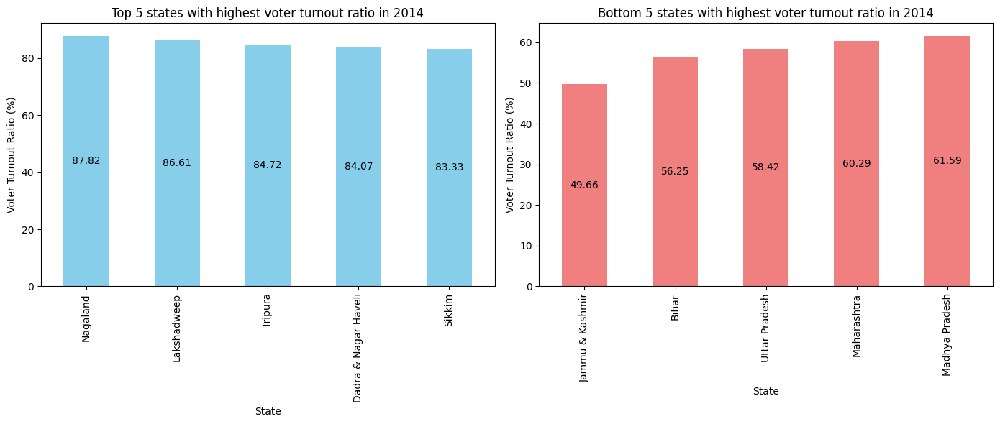

In [33]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Plot the top 5 states' voter turnout ratio as a bar chart on the first subplot (left)
top5_state14.plot(kind='bar', ax=axes[0], color='skyblue')
axes[0].set_title('Top 5 states with highest voter turnout ratio in 2014')
axes[0].set_xlabel('State')
axes[0].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the first subplot, positioned in the middle
for container in axes[0].containers:
    axes[0].bar_label(container, label_type='center')

# Plot the bottom 5 states' voter turnout ratio as a bar chart on the second subplot (right)
bottom5_state14.plot(kind='bar', ax=axes[1], color='lightcoral')
axes[1].set_title('Bottom 5 states with highest voter turnout ratio in 2014')
axes[1].set_xlabel('State')
axes[1].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the second subplot, positioned in the middle
for container in axes[1].containers:
    axes[1].bar_label(container, label_type='center')

# Adjust the layout to prevent overlapping elements
plt.tight_layout()

# Display the plot
plt.show()

**2019**

In [37]:
#getting unique totalelectors per pc_name
unique_ls_2019 = ls_2019.drop_duplicates(subset=['pc_name'])

#getting totalelectors per state
total_electors_state19 = unique_ls_2019.groupby('state')['total_electors'].sum()

#getting totalvotes per state
total_voters_state19 = ls_2019.groupby('state')['total_votes'].sum()

#getting voter_turnout_ratio_2014 by state
voter_turnout_ratio_state19 = round((total_voters_state19/total_electors_state19)*100,2)
voter_turnout_ratio_state19

state
Andaman & Nicobar Islands    65.09
Andhra Pradesh               80.22
Arunachal Pradesh            81.15
Assam                        81.57
Bihar                        57.30
Chandigarh                   70.60
Chhattisgarh                 71.59
Dadra & Nagar Haveli         79.58
Daman & Diu                  71.85
Goa                          75.10
Gujarat                      64.41
Haryana                      70.23
Himachal Pradesh             72.24
Jammu & Kashmir              44.84
Jharkhand                    66.78
Karnataka                    68.77
Kerala                       77.79
Lakshadweep                  85.18
Madhya Pradesh               71.16
Maharashtra                  60.96
Manipur                      82.54
Meghalaya                    71.40
Mizoram                      63.05
NCT OF Delhi                 60.58
Nagaland                     82.91
Odisha                       73.22
Puducherry                   81.24
Punjab                       65.89
Rajasthan     

In [38]:
# Top 5 states by voter turnout ratio in 2019

# Sort the voter turnout ratios for states in descending order
top5_state19 = voter_turnout_ratio_state19.sort_values(ascending=False).head(5)

# Output the top 5 states with the highest voter turnout ratios
top5_state19

state
Lakshadweep    85.18
Nagaland       82.91
Manipur        82.54
Tripura        82.35
West Bengal    81.72
dtype: float64

In [39]:
# Bottom 5 states by voter turnout ratio in 2019

# Sort the voter turnout ratios for states in ascending order
bottom5_state19 = voter_turnout_ratio_state19.sort_values().head(5)

# Output the bottom 5 states with the lowest voter turnout ratios
bottom5_state19

state
Jammu & Kashmir    44.84
Bihar              57.30
Uttar Pradesh      59.18
NCT OF Delhi       60.58
Maharashtra        60.96
dtype: float64

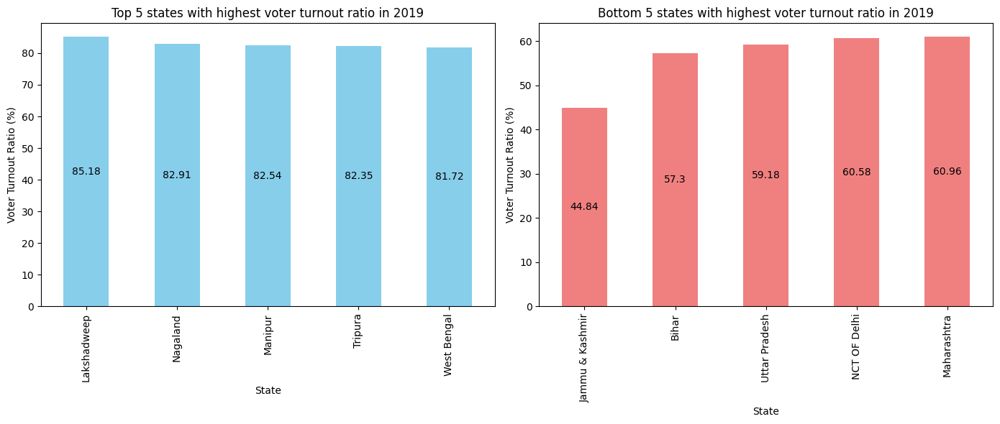

In [42]:
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Plot the top 5 states' voter turnout ratio as a bar chart on the first subplot (left)
top5_state19.plot(kind='bar', ax=axes[0], color='skyblue')
axes[0].set_title('Top 5 states with highest voter turnout ratio in 2019')
axes[0].set_xlabel('State')
axes[0].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the first subplot, positioned in the middle
for container in axes[0].containers:
    axes[0].bar_label(container, label_type='center')

# Plot the bottom 5 states' voter turnout ratio as a bar chart on the second subplot (right)
bottom5_state19.plot(kind='bar', ax=axes[1], color='lightcoral')
axes[1].set_title('Bottom 5 states with highest voter turnout ratio in 2019')
axes[1].set_xlabel('State')
axes[1].set_ylabel('Voter Turnout Ratio (%)')

# Add labels to each bar in the second subplot, positioned in the middle
for container in axes[1].containers:
    axes[1].bar_label(container, label_type='center')

# Adjust the layout to prevent overlapping elements
plt.tight_layout()

# Display the plot
plt.show()

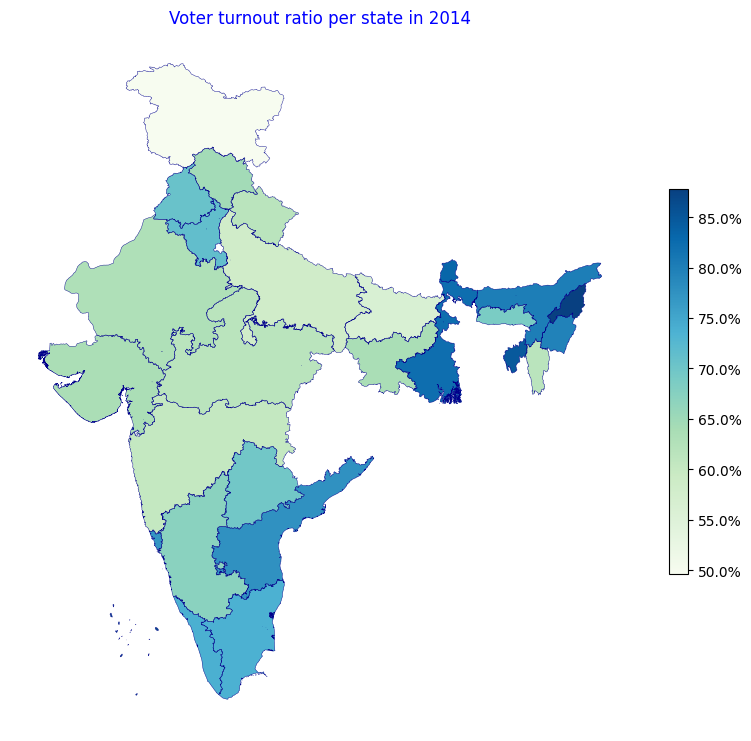

In [50]:
# Reading Indian states shape file
shp_gdf = gpd.read_file('states_shape/Indian_States.shp')
#shp_gdf.head()

# Turning voter_turnout_ratio_state14 series to DataFrame
df_vtr14 = pd.DataFrame({'State_Name': voter_turnout_ratio_state14.index, 'vtr_14': voter_turnout_ratio_state14.values})
#df_vtr14.head()

# Merging both files
df_vtr14 = pd.merge(df_vtr14, shp_gdf, left_on='State_Name', right_on='st_nm', how='left')

# Changing DataFrame type to GeoDataFrame
df_vtr14 = gpd.GeoDataFrame(df_vtr14)
type(df_vtr14)

# Plotting choropleth map
ax = df_vtr14.boundary.plot(edgecolor='darkblue', linewidth=0.3, figsize=(10,10))

df_vtr14.plot(ax=ax, column='vtr_14', cmap='GnBu',
              legend=True, legend_kwds={'shrink':0.5, 'format':'%.1f%%'})

# Removing axis and setting title
ax.axis('off')
ax.set_title('Voter turnout ratio per state in 2014', size=12, color='blue')

plt.show()


In [46]:
#Reading indian states shape file
shp_gdf = gpd.read_file('states_shape/Indian_States.shp')
#shp_gdf.head()

#turning voter_turnout_ratio_state19 series to df
df_vtr19 = pd.DataFrame({'State_Name': voter_turnout_ratio_state19.index, 'vtr_19': voter_turnout_ratio_state19.values})
#df_vtr19.head()

#merging both files
df_vtr19 = pd.merge(df_vtr19, shp_gdf, left_on = 'State_Name', right_on = 'st_nm', how = 'left')

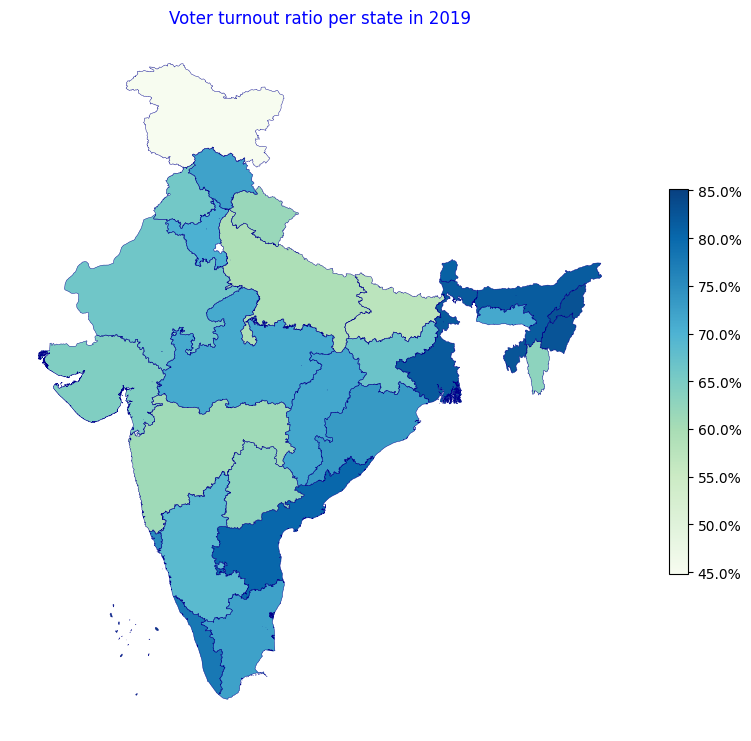

In [47]:
#chaniging df type to gdf
df_vtr19 = gpd.GeoDataFrame(df_vtr19)
type(df_vtr19)

#Plotting choropleth map
ax = df_vtr19.boundary.plot(edgecolor='darkblue', linewidth = 0.3, figsize=(10,10))

df_vtr19.plot(ax=ax, column='vtr_19', cmap='GnBu',
            legend=True, legend_kwds={'shrink':0.5, 'format':'%.1f%%'} )

#removing axis and setting title
ax.axis('off')
ax.set_title('Voter turnout ratio per state in 2019', size=12, color='blue')

plt.show()

##### 3. Which constituencies have elected the same party for two consecutive elections, rank them by % of votes to that winning party in 2019

In [52]:
#getting df of elected parties of 2014 & 2019
ls_elected_party14 = ls_2014.loc[ls_2014.groupby('pc_name')['total_votes'].idxmax()] 
ls_elected_party19 = ls_2019.loc[ls_2019.groupby('pc_name')['total_votes'].idxmax()]
#removing warning block
import warnings
warnings.filterwarnings('ignore')

In [54]:
#merge two df for comparison
df_merged_ep = pd.merge(ls_elected_party14, ls_elected_party19, on='pc_name', suffixes=('_14','_19'))

#filtering parties winning consecutively
df_matching_parties = df_merged_ep[df_merged_ep['party_14']==df_merged_ep['party_19']]

#finding percentage change
df_matching_parties['percentage_change'] = round(((df_matching_parties['total_votes_19']
                                                  -df_matching_parties['total_votes_14'])
                                                 /df_matching_parties['total_votes_19']*100),2)

#sorting by percentage
df_wp_ranked = df_matching_parties.sort_values(by = 'percentage_change', ascending=False)

print(df_wp_ranked[['pc_name','party_14','total_votes_14','party_19','total_votes_19', 'percentage_change']])

                     pc_name party_14  total_votes_14 party_19  \
420    Samastipur (SC)_Bihar      LJP          270401      LJP   
266        Kodarma_Jharkhand      BJP          365410      BJP   
431       Shillong_Meghalaya      INC          209340      INC   
503           Wayanad_Kerala      INC          377035      INC   
131          Darbhanga_Bihar      BJP          314949      BJP   
..                       ...      ...             ...      ...   
130  Daman & diu_Daman & Diu      BJP           46960      BJP   
377    Peddapalle _Telangana      TRS          565496      TRS   
423           Sangrur_Punjab     AAAP          533237     AAAP   
267          Kokrajhar_Assam      IND          634428      IND   
265         Kishanganj_Bihar      INC          493461      INC   

     total_votes_19  percentage_change  
420          562443              51.92  
266          753016              51.47  
431          419689              50.12  
503          706367              46.62  
13

##### **Plotting constituencies that elected same party for consecutive years by % Change in Votes**

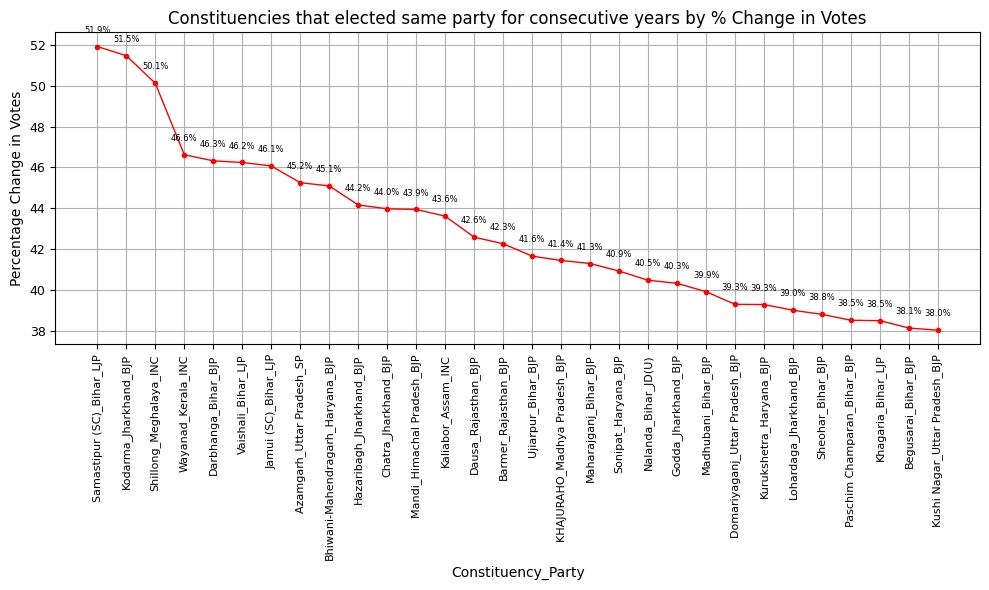

In [58]:
import matplotlib.pyplot as plt  # Importing the matplotlib.pyplot module for plotting

# Selecting the top 30 constituencies based on some ranking criteria
df_wp = df_wp_ranked.head(30)

# Concatenating constituency and party name to create labels for the x-axis
labels = [f'{cons}_{party}' for cons, party in zip(df_wp['pc_name'], df_wp['party_14'])]

# Plotting the data
plt.figure(figsize=(10,6))  # Creating a new figure with a specified size
plt.plot(labels, df_wp['percentage_change'], 'r.-', linewidth=1)  # Plotting the percentage change in votes for the top 30 constituencies
plt.xlabel('Constituency_Party')  # Setting the label for the x-axis
plt.ylabel('Percentage Change in Votes')  # Setting the label for the y-axis
plt.title('Constituencies that elected same party for consecutive years by % Change in Votes')  # Setting the title of the plot
plt.tick_params(axis='x', labelrotation=90, labelsize=8)  # Rotating the x-axis labels by 90 degrees and setting the label size
plt.tick_params(axis='y', labelsize=9)  # Setting the y-axis label size
plt.grid(True)  # Enabling the grid on the plot
plt.tight_layout()  # Adjusting the layout to prevent overlap and ensure everything fits within the figure

# Adding labels to each data point
for i, txt in enumerate(df_wp['percentage_change']):
    plt.annotate(f'{txt:.1f}%', (labels[i], df_wp['percentage_change'].iat[i]),
                 textcoords="offset points", xytext=(0,10), ha='center', fontsize=6)

plt.show()  # Displaying the plot


##### **4. Which constituencies have voted for different parties in two elections (list top 10 based on the difference (2019-2014) in voter percentage in two elections)**

In [59]:
#getting df of elected parties of 2014 & 2019
ls_elected_party14 = ls_2014.loc[ls_2014.groupby('pc_name')['total_votes'].idxmax()]
ls_elected_party19 = ls_2019.loc[ls_2019.groupby('pc_name')['total_votes'].idxmax()]

#merge two df for comparison
df_merged_cp = pd.merge(ls_elected_party14, ls_elected_party19, on='pc_name', suffixes=('_14','_19'))

df_merged_cp['max_total_votes']=df_merged_cp[['total_votes_14','total_votes_19']].max(axis=1)

#filtering constituencies where parties changed
df_changed_parties = df_merged_cp[df_merged_cp['party_14']!=df_merged_cp['party_19']]

#finding percentage change
df_changed_parties['percentage_change'] = round(((df_changed_parties['total_votes_19']
                                                  -df_changed_parties['total_votes_14'])
                                                 /df_changed_parties['max_total_votes']*100),2)

#sorting by percentage
df_cp_ranked = df_changed_parties.sort_values(by = 'percentage_change', ascending=False).head(10)

print(df_cp_ranked[['pc_name','party_14','total_votes_14','party_19','total_votes_19', 'percentage_change']])

                       pc_name party_14  total_votes_14 party_19  \
13     Alipurduars_West Bengal     AITC          362453      BJP   
175     Ghazipur_Uttar Pradesh      BJP          306929      BSP   
421      Sambhal_Uttar Pradesh      BJP          360242       SP   
225          Jhanjharpur_Bihar      BJP          335481    JD(U)   
454               Supaul_Bihar      INC          332927    JD(U)   
42   Autonomous District_Assam      INC          213152      BJP   
116    Chikkballapur_Karnataka      INC          424800      BJP   
385      Puducherry_Puducherry    AINRC          255826      INC   
268            Kolar_Karnataka      INC          418926      BJP   
297            Madhepura_Bihar      RJD          368937    JD(U)   

     total_votes_19  percentage_change  
13           750804              51.72  
175          566082              45.78  
421          658006              45.25  
225          602391              44.31  
454          597377              44.27  
42   

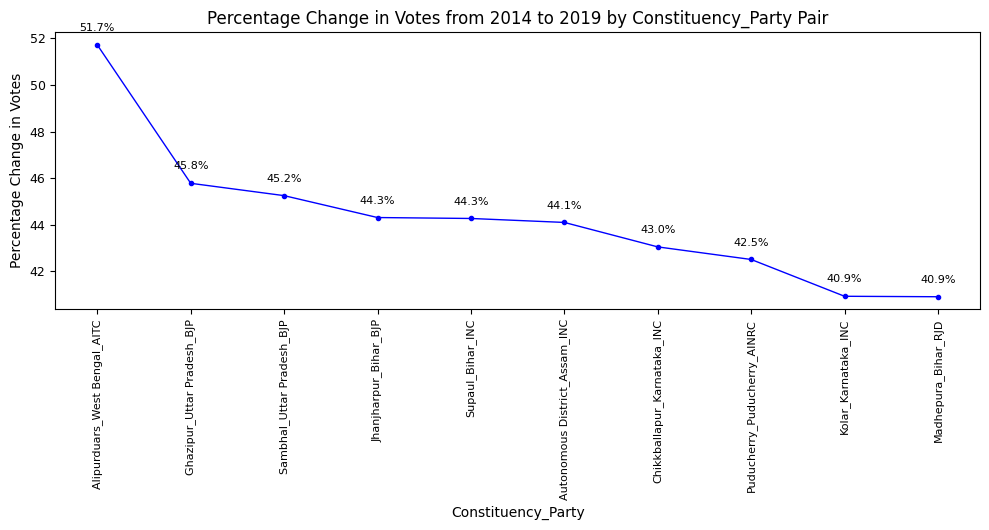

In [77]:
# Concatenating constituency and party name to create labels for the x-axis
labels = [f'{cons}_{party}' for cons, party in zip(df_cp_ranked['pc_name'], df_cp_ranked['party_14'])]

# Plotting the data
fig, ax = plt.subplots(figsize=(10,6))  # Creating a new figure with a specified size
ax.plot(labels, df_cp_ranked['percentage_change'], 'b.-', linewidth=1)  # Plotting the percentage change in votes for the ranked constituencies
ax.set_xlabel('Constituency_Party')  # Setting the label for the x-axis
ax.set_ylabel('Percentage Change in Votes')  # Setting the label for the y-axis
ax.set_title('Percentage Change in Votes from 2014 to 2019 by Constituency_Party Pair')  # Setting the title of the plot
ax.tick_params(axis='x', labelrotation=90, labelsize=8)  # Rotating the x-axis labels by 90 degrees and setting the label size
ax.tick_params(axis='y', labelsize=9)  # Setting the y-axis label size



# Adding labels to each data point
for i, txt in enumerate(df_cp_ranked['percentage_change']):  # Iterating over the percentage change values
    ax.annotate(f'{txt:.1f}%',  # Formatting the percentage change value as a string with one decimal place followed by '%'
                (i, df_cp_ranked['percentage_change'].iat[i]),  # Specifying the coordinates for the annotation (x, y)
                textcoords="offset points",  # Positioning the text relative to the specified coordinates
                xytext=(0,10),  # Offsetting the text by 10 points vertically
                ha='center',  # Horizontally aligning the text to be centered
                fontsize=8)  # Setting the font size for the annotation

plt.tight_layout(rect=[0, 0, 1, 0.9])  # Adjusting the layout to prevent overlap and ensure everything fits within the figure
plt.show()  # Displaying the plot


##### **5. Top 5 candidates based on margin difference with runners in 2014 and 2019**

**2014**

In [79]:
# Getting the top 2 parties of each constituency based on total votes
top2_parties14 = ls_2014.groupby('pc_name').apply(lambda x: x.nlargest(2, 'total_votes', 'all')).reset_index(drop=True)

# Calculating the difference in total votes between the top 2 parties for each constituency
top2_parties14['margin_difference'] = top2_parties14.groupby('pc_name')['total_votes'].diff().abs()

# Filtering the top 5 runners-up based on the largest margin difference
top5_runners_margin = top2_parties14.nlargest(5, 'margin_difference')

# Filling NaN values in the DataFrame by backfilling
df_winners_runners = top2_parties14.fillna(method='bfill')

# Getting the winners (top party) for each constituency based on the largest margin difference
top_winners = df_winners_runners.groupby('pc_name').apply(lambda x: x.nlargest(1, 'margin_difference')).reset_index(drop=True)

# Filtering the top 5 winners based on the largest margin difference
top5_winners_margin = top_winners.nlargest(5, 'margin_difference')


In [80]:
# Merging both winners and runners-up DataFrames on the 'pc_name' column
top_margin = pd.merge(top5_winners_margin, top5_runners_margin, on='pc_name')

# Renaming columns for better readability
top_margin.rename(columns={
    'candidate_x': 'winning_candidate',       # Renaming 'candidate_x' to 'winning_candidate'
    'candidate_y': 'runner_candidate',        # Renaming 'candidate_y' to 'runner_candidate'
    'party_x': 'winning_party',               # Renaming 'party_x' to 'winning_party'
    'party_y': 'runner_party',                # Renaming 'party_y' to 'runner_party'
    'margin_difference_y': 'margin_difference'  # Renaming 'margin_difference_y' to 'margin_difference'
}, inplace=True)

# Printing both winners and runners-up by largest margin
print(top_margin[['pc_name', 'winning_candidate', 'winning_party', 'runner_candidate', 'runner_party', 'margin_difference']])


                   pc_name        winning_candidate winning_party  \
0         Vadodara_Gujarat            NARENDRA MODI           BJP   
1  Ghaziabad_Uttar Pradesh        VIJAY KUMAR SINGH           BJP   
2          Navsari_Gujarat              C. R. PATIL           BJP   
3         Jaipur_Rajasthan         RAMCHARAN BOHARA           BJP   
4            Surat_Gujarat  DARSHANA VIKRAM JARDOSH           BJP   

                runner_candidate runner_party  margin_difference  
0       MISTRI MADHUSUDAN DEVRAM          INC           570128.0  
1                     RAJ BABBAR          INC           567260.0  
2                   MAKSUD MIRZA          INC           558116.0  
3               DR. MAHESH JOSHI          INC           539345.0  
4  DESAI NAISHADHBHAI BHUPATBHAI          INC           533190.0  


**2019**

In [83]:
# Getting the top 2 parties of each constituency based on total votes
top2_parties19 = ls_2019.groupby('pc_name').apply(lambda x: x.nlargest(2, 'total_votes', 'all')).reset_index(drop=True)

# Calculating the difference in total votes between the top 2 parties for each constituency
top2_parties19['margin_difference'] = top2_parties19.groupby('pc_name')['total_votes'].diff().abs()

# Filtering the top 5 runners-up based on the largest margin difference
top5_runners_margin_2 = top2_parties19.nlargest(5, 'margin_difference')

# Filling NaN values in the DataFrame by backfilling
df_winners_runners = top2_parties19.fillna(method='bfill')

# Getting the winners (top party) for each constituency based on the largest margin difference
top_winners = df_winners_runners.groupby('pc_name').apply(lambda x: x.nlargest(1, 'margin_difference')).reset_index(drop=True)

# Filtering the top 5 winners based on the largest margin difference
top5_winners_margin_2 = top_winners.nlargest(5, 'margin_difference')

In [84]:
# Merging both winners and runners-up DataFrames on the 'pc_name' column
top_margin = pd.merge(top5_winners_margin_2, top5_runners_margin_2, on='pc_name')

# Renaming columns for better readability
top_margin.rename(columns={
    'candidate_x': 'winning_candidate',       # Renaming 'candidate_x' to 'winning_candidate'
    'candidate_y': 'runner_candidate',        # Renaming 'candidate_y' to 'runner_candidate'
    'party_x': 'winning_party',               # Renaming 'party_x' to 'winning_party'
    'party_y': 'runner_party',                # Renaming 'party_y' to 'runner_party'
    'margin_difference_y': 'margin_difference'  # Renaming 'margin_difference_y' to 'margin_difference'
}, inplace=True)

# Printing both winners and runners-up by largest margin
print(top_margin[['pc_name', 'winning_candidate', 'winning_party', 'runner_candidate', 'runner_party', 'margin_difference']])

              pc_name        winning_candidate winning_party  \
0     Navsari_Gujarat              C. R. Patil           BJP   
1      Karnal_Haryana            Sanjay Bhatia           BJP   
2   Faridabad_Haryana              KRISHAN PAL           BJP   
3  Bhilwara_Rajasthan  SUBHASH CHANDRA BAHERIA           BJP   
4    Vadodara_Gujarat          RANJANBEN BHATT           BJP   

              runner_candidate runner_party  margin_difference  
0  PATEL DHARMESHBHAI BHIMBHAI          INC           689668.0  
1                Kuldip Sharma          INC           656142.0  
2          AVTAR SINGH BHADANA          INC           638239.0  
3               RAM PAL SHARMA          INC           612000.0  
4        PRASHANT PATEL (TIKO)          INC           589177.0  


##### **6. % Split of votes of parties between 2014 vs 2019 at national level**

In [86]:
# Votes for each party in 2014
party_votes14 = ls_2014.groupby('party')['total_votes'].sum().reset_index()  # Grouping the 2014 DataFrame by party and summing the total votes for each party, then resetting the index

# Total votes in 2014 elections
total_votes14 = ls_2014['total_votes'].sum()  # Calculating the total number of votes in the 2014 elections

# Calculating percentage of votes per party in 2014
party_votes14['percentage'] = (party_votes14['total_votes'] / total_votes14) * 100  # Calculating the percentage of total votes for each party

# Top 10 parties by percentage of votes in 2014
top10_parties14 = party_votes14.sort_values(by='percentage', ascending=False).head(10)  # Sorting the parties by percentage of votes in descending order and selecting the top 10

# Votes for each party in 2019
party_votes19 = ls_2019.groupby('party')['total_votes'].sum().reset_index()  # Grouping the 2019 DataFrame by party and summing the total votes for each party, then resetting the index

# Total votes in 2019 elections
total_votes19 = ls_2019['total_votes'].sum()  # Calculating the total number of votes in the 2019 elections

# Calculating percentage of votes per party in 2019
party_votes19['percentage'] = (party_votes19['total_votes'] / total_votes19) * 100  # Calculating the percentage of total votes for each party

# Top 10 parties by percentage of votes in 2019
top10_parties19 = party_votes19.sort_values(by='percentage', ascending=False).head(10)  # Sorting the parties by percentage of votes in descending order and selecting the top 10


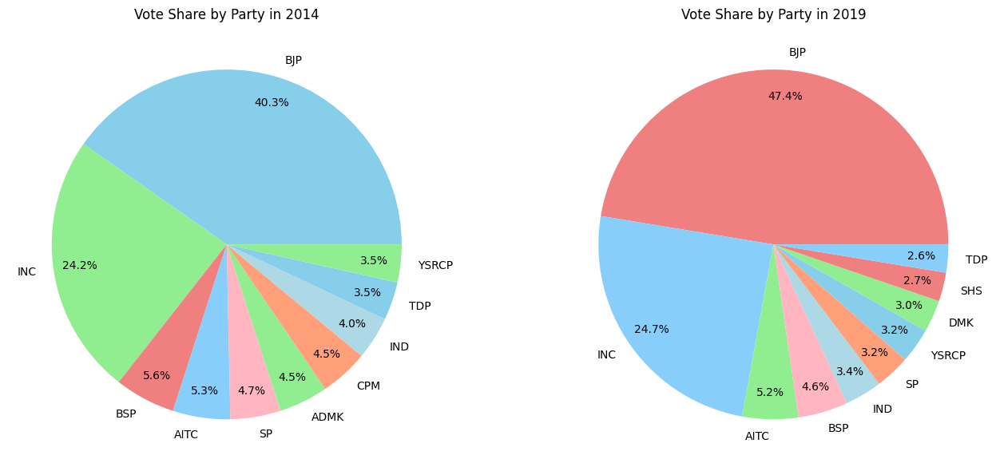

In [89]:
# Setting variables for plotting
labels14 = top10_parties14['party']  # Extracting the party names for 2014
share14 = top10_parties14['percentage']  # Extracting the vote percentage for each party in 2014

labels19 = top10_parties19['party']  # Extracting the party names for 2019
share19 = top10_parties19['percentage']  # Extracting the vote percentage for each party in 2019

# Defining colors for the pie charts
colors14 = ['skyblue', 'lightgreen', 'lightcoral', 'lightskyblue', 'lightpink', 'lightgreen', 'lightsalmon', 'lightblue']  # Colors for 2014 pie chart
colors19 = ['lightcoral', 'lightskyblue', 'lightgreen', 'lightpink', 'lightblue', 'lightsalmon', 'skyblue', 'lightgreen']  # Colors for 2019 pie chart

# Plotting pie charts showing the percentage split of votes of parties between 2014 and 2019 at the national level
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14,6))  # Creating a figure with two subplots arranged in 1 row and 2 columns

# Plotting the 2014 pie chart
share14.plot(kind='pie', ax=axes[0], colors=colors14, labels=labels14, autopct='%1.1f%%', pctdistance=0.85)  # Plotting the pie chart for 2014 vote share
axes[0].set_title('Vote Share by Party in 2014')  # Setting the title for the 2014 pie chart
axes[0].set_ylabel('')  # Removing the y-axis label for the 2014 pie chart

# Plotting the 2019 pie chart
share19.plot(kind='pie', ax=axes[1], colors=colors19, labels=labels19, autopct='%1.1f%%', pctdistance=0.85)  # Plotting the pie chart for 2019 vote share
axes[1].set_title('Vote Share by Party in 2019')  # Setting the title for the 2019 pie chart
axes[1].set_ylabel('')  # Removing the y-axis label for the 2019 pie chart

plt.tight_layout()  # Adjusting the layout to prevent overlap and ensure everything fits within the figure
plt.show()  # Displaying the plot


**7. % Split of votes of parties between 2014 vs 2019 at state level**

In [90]:
#grouping votes by states
state_votes14 = ls_2014.groupby(['state','party'])['total_votes'].sum().reset_index()
#total votes
total_state_votes14 = state_votes14['total_votes'].sum()
#calculating votes percentage
state_votes14['vote_share']=(state_votes14['total_votes']/total_state_votes14)*100
#sorting top20 states for plotting
sorted_state_votes14 = state_votes14.sort_values(by='vote_share', ascending=False).head(20)

#plotting graph
fig = px.bar(sorted_state_votes14, x='vote_share', y='state', color='party',orientation='h',
             labels={'state':'State', 'vote_share':'Vote Share%', 'party':'Party'},
             title='Vote Share of Parties in Top States in 2014',
             hover_data={'vote_share': ':.2f'})

fig.update_layout(yaxis={'categoryorder':'total ascending'},
                  xaxis=dict(title='Vote Share (%)'),
                  legend_title='Party')

fig.show()


**2019**

In [91]:
#grouping votes by states
state_votes19 = ls_2019.groupby(['state','party'])['total_votes'].sum().reset_index()
#total votes
total_state_votes19 = state_votes19['total_votes'].sum()
#calculating votes percentage
state_votes19['vote_share']=(state_votes19['total_votes']/total_state_votes19)*100
#sorting top20 states for plotting
sorted_state_votes19 = state_votes19.sort_values(by='vote_share', ascending=False).head(20)

#plotting graph
fig = px.bar(sorted_state_votes19, x='vote_share', y='state', color='party',orientation='h',
             labels={'state':'State', 'vote_share':'Vote Share%', 'party':'Party'},
             title='Vote Share of Parties in Top States in 2019',
             hover_data={'vote_share': ':.2f'})

fig.update_layout(yaxis={'categoryorder':'total ascending'},
                  xaxis=dict(title='Vote Share (%)'),
                  legend_title='Party')

fig.show()

**8. List top 5 constituencies for two major national parties where they have gained vote share in 2019 as compared to 2014**

In [93]:
#2 major national parties
national_parties = ['BJP','INC']

#pivoting df
party_votes14 = ls_2014.groupby(['pc_name','party'])['total_votes'].sum().unstack(fill_value=0)
party_votes19 = ls_2019.groupby(['pc_name','party'])['total_votes'].sum().unstack(fill_value=0)

#substracting pivotted df to get difference in votes  
vote_share_gained = party_votes19 - party_votes14

#filtering difference for only major parties
national_parties_votes = vote_share_gained[national_parties]

#sorting by top5
top5_constituencies_BJP = national_parties_votes['BJP'].sort_values(ascending=False).head(5)
top5_constituencies_INC = national_parties_votes['INC'].sort_values(ascending=False).head(5)

#printing result
print("Top 5 constituencies where BJP gained vote share:")
print(top5_constituencies_BJP)
print("\nTop 5 constituencies where INC gained vote share:")
print(top5_constituencies_INC)

Top 5 constituencies where BJP gained vote share:
pc_name
Sirsa_Haryana           714351.0
Hisar_Haryana           603289.0
Madha_Maharashtra       586314.0
Purulia_West Bengal     581871.0
Ranaghat_West Bengal    549583.0
Name: BJP, dtype: float64

Top 5 constituencies where INC gained vote share:
pc_name
Thiruvallur _Tamil Nadu       723332.0
Karur_Tamil Nadu              665238.0
Arani_Tamil Nadu              590043.0
Krishnagiri_Tamil Nadu        572413.0
Tiruchirappalli_Tamil Nadu    569748.0
Name: INC, dtype: float64


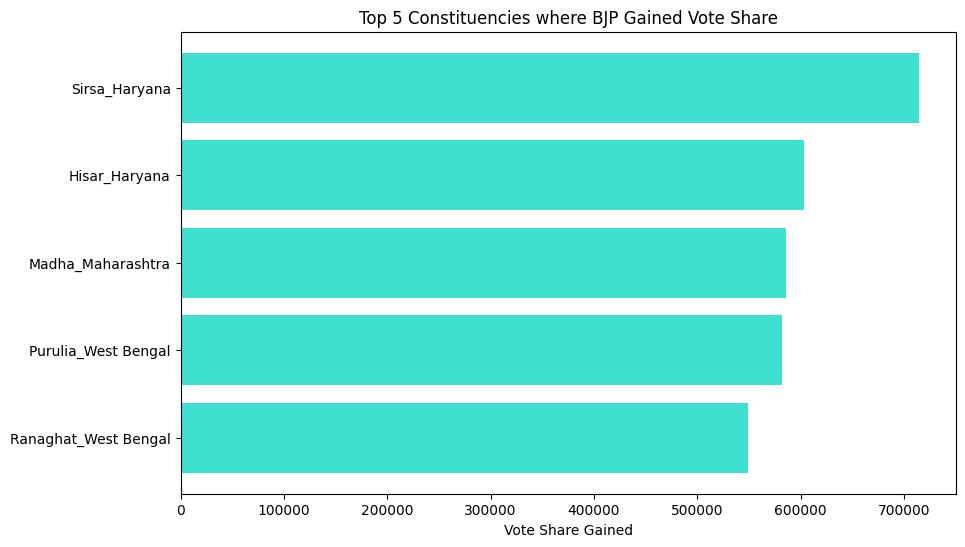

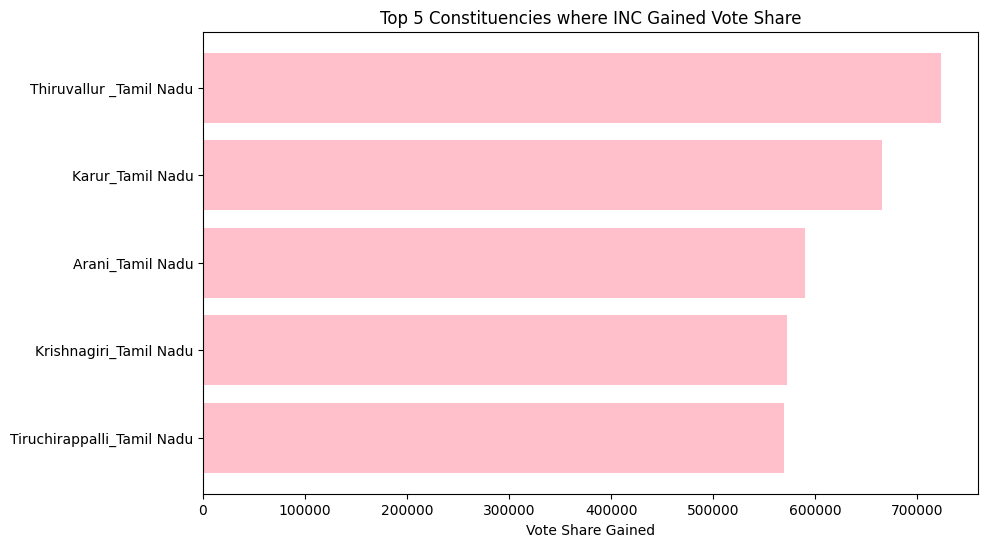

In [94]:
#plotting for BJP
plt.figure(figsize=(10,6))
plt.barh(top5_constituencies_BJP.index, top5_constituencies_BJP, color='turquoise')
plt.xlabel('Vote Share Gained')
plt.title('Top 5 Constituencies where BJP Gained Vote Share')
plt.gca().invert_yaxis()
plt.show()

#plotting for INC
plt.figure(figsize=(10,6))
plt.barh(top5_constituencies_INC.index, top5_constituencies_INC, color='pink')
plt.xlabel('Vote Share Gained')
plt.title('Top 5 Constituencies where INC Gained Vote Share')
plt.gca().invert_yaxis()
plt.show()

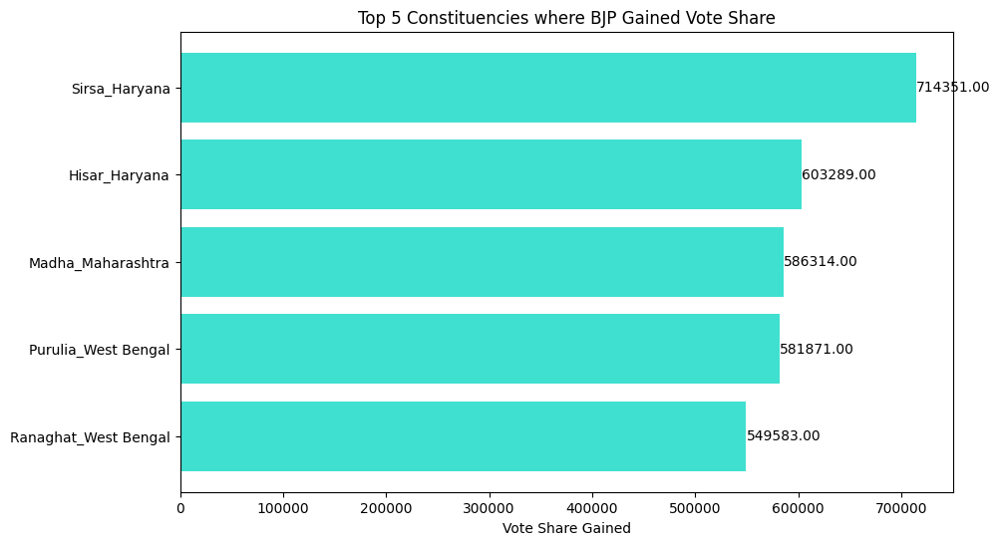

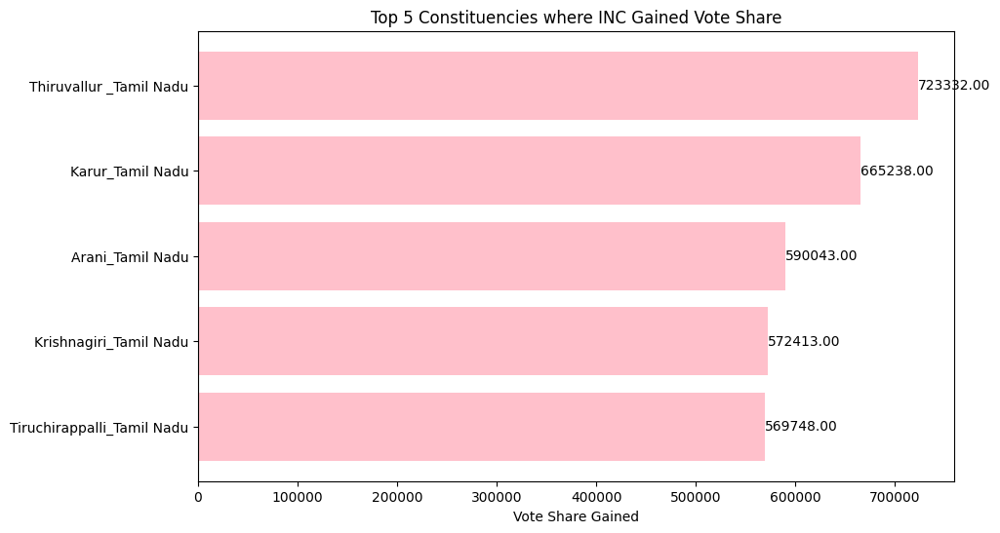

In [95]:
#plotting for BJP
plt.figure(figsize=(10,6))
bars = plt.barh(top5_constituencies_BJP.index, top5_constituencies_BJP, color='turquoise')
plt.xlabel('Vote Share Gained')
plt.title('Top 5 Constituencies where BJP Gained Vote Share')
plt.gca().invert_yaxis()

# Adding labels
for bar in bars:
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.2f}', va='center')

plt.show()

#plotting for INC
plt.figure(figsize=(10,6))
bars = plt.barh(top5_constituencies_INC.index, top5_constituencies_INC, color='pink')
plt.xlabel('Vote Share Gained')
plt.title('Top 5 Constituencies where INC Gained Vote Share')
plt.gca().invert_yaxis()

# Adding labels
for bar in bars:
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.2f}', va='center')

plt.show()


**9. List top 5 constituencies for two major national parties where they have lost vote share in 2019 as compared to 2014**

In [97]:
# Define the two major national parties
national_parties = ['BJP','INC']

# Pivot the 2014 dataframe to get total votes for each party in each constituency
party_votes14 = ls_2014.groupby(['pc_name','party'])['total_votes'].sum().unstack(fill_value=0)

# Pivot the 2019 dataframe to get total votes for each party in each constituency
party_votes19 = ls_2019.groupby(['pc_name','party'])['total_votes'].sum().unstack(fill_value=0)

# Subtract the 2014 votes from the 2019 votes to get the difference in vote share
vote_share_gained = party_votes19 - party_votes14

# Replace votes with NaN where the difference is 0 or more (indicating no loss or a gain)
vote_share_gained[vote_share_gained>=0] = np.nan

# Filter the dataframe to include only the major national parties
national_parties_votes = vote_share_gained[national_parties]

# Sort the vote share difference for BJP in ascending order and get the top 5 constituencies where BJP lost the most votes
top5_constituencies_lost_BJP = national_parties_votes['BJP'].sort_values(ascending=True).head(5)

# Sort the vote share difference for INC in ascending order and get the top 5 constituencies where INC lost the most votes
top5_constituencies_lost_INC = national_parties_votes['INC'].sort_values(ascending=True).head(5)

# Print the results
print("Top 5 constituencies where BJP lost vote share:")
print(top5_constituencies_lost_BJP)
print("\nTop 5 constituencies where INC lost vote share:")
print(top5_constituencies_lost_INC)


Top 5 constituencies where BJP lost vote share:
pc_name
Palghar _Maharashtra           -533201.0
Visakhapatnam_Andhra Pradesh   -532940.0
Narsapuram_Andhra Pradesh      -527892.0
Tirupati _Andhra Pradesh       -526826.0
Gopalganj (SC)_Bihar           -478773.0
Name: BJP, dtype: float64

Top 5 constituencies where INC lost vote share:
pc_name
Mandya_Karnataka           -518852.0
Hatkanangle_Maharashtra    -462618.0
Tumkur_Karnataka           -429868.0
Hassan_Karnataka           -409379.0
Uttara Kannada_Karnataka   -406239.0
Name: INC, dtype: float64


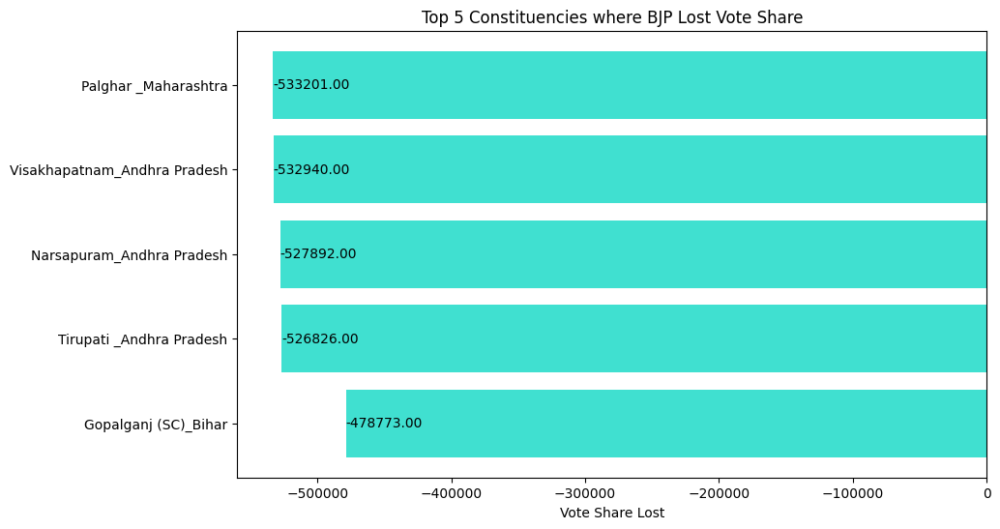

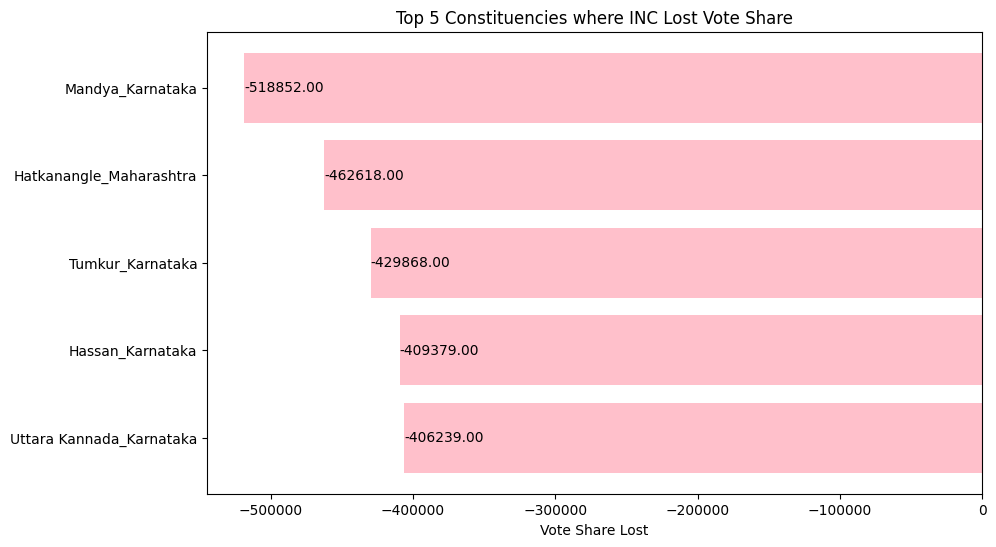

In [98]:
# Plotting for BJP
plt.figure(figsize=(10,6))  # Set the figure size
bars = plt.barh(top5_constituencies_lost_BJP.index, top5_constituencies_lost_BJP, color='turquoise')  # Create a horizontal bar plot
plt.xlabel('Vote Share Lost')  # Set the x-axis label
plt.title('Top 5 Constituencies where BJP Lost Vote Share')  # Set the plot title
plt.gca().invert_yaxis()  # Invert the y-axis to have the highest value at the top

# Adding labels to the bars
for bar in bars:
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.2f}', va='center')  # Add text labels to the bars

plt.show()  # Display the plot

# Plotting for INC
plt.figure(figsize=(10,6))  # Set the figure size
bars = plt.barh(top5_constituencies_lost_INC.index, top5_constituencies_lost_INC, color='pink')  # Create a horizontal bar plot
plt.xlabel('Vote Share Lost')  # Set the x-axis label
plt.title('Top 5 Constituencies where INC Lost Vote Share')  # Set the plot title
plt.gca().invert_yaxis()  # Invert the y-axis to have the highest value at the top

# Adding labels to the bars
for bar in bars:
    plt.text(bar.get_width(), bar.get_y() + bar.get_height()/2, f'{bar.get_width():.2f}', va='center')  # Add text labels to the bars

plt.show()  # Display the plot


**10. Which constituency has voted the most for NOTA?**

**2014**

In [101]:
#getting NOTA for each constituencies
nota14 = ls_2014[ls_2014['candidate']=='None of the Above']  # Filter the dataframe to get rows where the candidate is 'None of the Above' (NOTA)

#sorting by most votes
sorted_nota14 = nota14.sort_values(by='total_votes', ascending=False).head(10)  # Sort the filtered dataframe by total votes in descending order and select the top 10 rows

#removing suffixes of state from constituency
sorted_nota14['pc_name'] = sorted_nota14['pc_name'].str.split('_').str[0]  # Remove the state suffix from the constituency name by splitting the string and taking the first part

#plotting
fig = px.bar(sorted_nota14, x='pc_name', y='total_votes', title='Total NOTA votes per constituency in 2014',
            text='total_votes', height=500)  # Create a bar plot with constituency names on the x-axis and total votes on the y-axis, add labels, and set the height

fig.update_traces(textposition='inside')  # Position the text labels inside the bars

fig.show()  # Display the plot


In [103]:
#getting NOTA for each constituencies
nota19 = ls_2019[ls_2019['candidate']=='NOTA']  # Filter the dataframe to get rows where the candidate is 'NOTA'

#sorting by most votes
sorted_nota19 = nota19.sort_values(by='total_votes', ascending=False).head(10)  # Sort the filtered dataframe by total votes in descending order and select the top 10 rows

#removing suffixes of state from constituency
sorted_nota19['pc_name'] = sorted_nota19['pc_name'].str.split('_').str[0]  # Remove the state suffix from the constituency name by splitting the string and taking the first part

#plotting
fig = px.bar(sorted_nota19, x='pc_name', y='total_votes', title='Total NOTA votes per constituency in 2019',
            text='total_votes', height=500)  # Create a bar plot with constituency names on the x-axis and total votes on the y-axis, add labels, and set the height

fig.update_traces(textposition='inside')  # Position the text labels inside the bars

fig.show()  # Display the plot


**11. Which constituencies have elected candidates whose party has less than 10% vote share at state level in 2019**

In [106]:
# Calculating total votes cast for each party in each constituency
party_votes = ls_2019.groupby(['state','pc_name','candidate','party'])['total_votes'].sum().reset_index()  # Group by state, constituency, candidate, and party, then sum the total votes

# Determining the winning party for each constituency
winning_party_indices = party_votes.groupby('pc_name')['total_votes'].idxmax()  # Get the index of the maximum total votes for each constituency
winning_party = party_votes.loc[winning_party_indices]  # Use the indices to get the rows corresponding to the winning party for each constituency

# Calculating total votes cast in each state
total_votes_state = ls_2019.groupby('state')['total_votes'].sum().reset_index()  # Group by state and sum the total votes

# Merging the two dataframes
winning_parties = pd.merge(winning_party, total_votes_state, on='state', suffixes=['_party','_total'])  # Merge the winning party dataframe with the total votes dataframe on state

# Calculating percentage vote share for the winning party in each constituency by state
winning_parties['vote_share_percentage'] = (winning_parties['total_votes_party']/winning_parties['total_votes_total'])*100  # Calculate the vote share percentage for the winning party

# Identifying constituencies with less than 10% vote share
constituencies_less_than_10_percent = winning_parties[winning_parties['vote_share_percentage']<10][['pc_name','candidate','party','vote_share_percentage']]  # Filter constituencies with less than 10% vote share

# Printing constituencies name
print("Constituencies where the winning party's vote share is less than 10% at the state level in 2019:")
print(constituencies_less_than_10_percent.sort_values(by='vote_share_percentage').head(10))  # Print the top 10 constituencies with the lowest vote share percentage


Constituencies where the winning party's vote share is less than 10% at the state level in 2019:
                            pc_name             candidate party  \
282         Kaushambi_Uttar Pradesh    VINOD KUMAR SONKAR   BJP   
414        Pratapgarh_Uttar Pradesh      SANGAM LAL GUPTA   BJP   
472         Shrawasti_Uttar Pradesh         RAM SHIROMANI   BSP   
443       Robertsganj_Uttar Pradesh       PAKAURI LAL KOL  ADAL   
489         Sultanpur_Uttar Pradesh  MANEKA SANJAI GANDHI   BJP   
460  Sant Kabir Nagar_Uttar Pradesh  PRAVEEN KUMAR NISHAD   BJP   
454          Salempur_Uttar Pradesh              RAVINDER   BJP   
20             Amethi_Uttar Pradesh          Smriti Irani   BJP   
273            Kanpur_Uttar Pradesh     Satyadev Pachauri   BJP   
58             Ballia_Uttar Pradesh        Virendra Singh   BJP   

     vote_share_percentage  
282               0.442880  
414               0.504491  
472               0.510828  
443               0.517931  
489               0.

**12. Is there a correlation between postal votes % and voter turnout % ?**

In [107]:
# 2014
# Postal votes of states
postal_votes_state14 = ls_2014.groupby('state')['postal_votes'].sum()  # Group by state and sum the postal votes

# Total postal votes of the country
postal_votes_total14 = ls_2014['postal_votes'].sum()  # Sum the postal votes for the entire country

# Postal votes percentage
postal_votes_pct14 = round((postal_votes_state14/postal_votes_total14)*100, 2)  # Calculate the percentage of postal votes for each state

# Filtering total electors per constituency
unique_ls_2014 = ls_2014.drop_duplicates(subset=['pc_name'])  # Remove duplicate rows based on constituency name

# Total electors per state
total_electors_state14 = unique_ls_2014.groupby('state')['total_electors'].sum()  # Group by state and sum the total electors
total_electors_state14

# Total votes per state
total_votes_state14 = ls_2014.groupby('state')['total_votes'].sum()  # Group by state and sum the total votes

# Voter turnout percentage
voter_turnout_pct14 = round((total_votes_state14/total_electors_state14)*100, 2)  # Calculate the voter turnout percentage for each state

# Creating correlation dataframe
correlation_ls_2014 = pd.DataFrame({'Postal Votes (%) 2014': postal_votes_pct14,
                                    'Voter Turnout (%) 2014': voter_turnout_pct14})  # Create a dataframe with postal votes percentage and voter turnout percentage for 2014

# -------------------------------------------------------------------------------------------
# 2019
# Postal votes of states
postal_votes_state19 = ls_2019.groupby('state')['postal_votes'].sum()  # Group by state and sum the postal votes

# Total postal votes of the country
postal_votes_total19 = ls_2019['postal_votes'].sum()  # Sum the postal votes for the entire country

# Postal votes percentage
postal_votes_pct19 = round((postal_votes_state19/postal_votes_total19)*100, 2)  # Calculate the percentage of postal votes for each state

# Filtering total electors per constituency
unique_ls_2019 = ls_2019.drop_duplicates(subset=['pc_name'])  # Remove duplicate rows based on constituency name

# Total electors per state
total_electors_state19 = unique_ls_2019.groupby('state')['total_electors'].sum()  # Group by state and sum the total electors
total_electors_state19

# Total votes per state
total_votes_state19 = ls_2019.groupby('state')['total_votes'].sum()  # Group by state and sum the total votes

# Voter turnout percentage
voter_turnout_pct19 = round((total_votes_state19/total_electors_state19)*100, 2)  # Calculate the voter turnout percentage for each state

# Creating correlation dataframe
correlation_ls_2019 = pd.DataFrame({'Postal Votes (%) 2019': postal_votes_pct19,
                                    'Voter Turnout (%) 2019': voter_turnout_pct19})  # Create a dataframe with postal votes percentage and voter turnout percentage for 2019


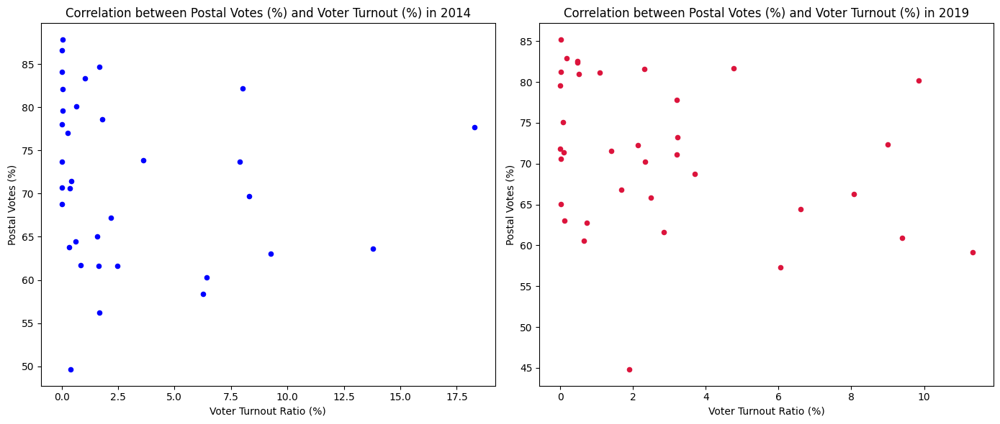

In [109]:
# Creating subplots with 1 row and 2 columns
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14,6))  # Set the figure size

# Plotting the correlation for 2014
correlation_ls_2014.plot(kind='scatter', ax=axes[0], color='blue', x='Postal Votes (%) 2014', y='Voter Turnout (%) 2014')  # Create a scatter plot for 2014 data
axes[0].set_title('Correlation between Postal Votes (%) and Voter Turnout (%) in 2014')  # Set the title for the first subplot
axes[0].set_ylabel('Postal Votes (%)')  # Set the y-axis label for the first subplot
axes[0].set_xlabel('Voter Turnout Ratio (%)')  # Set the x-axis label for the first subplot

# Plotting the correlation for 2019
correlation_ls_2019.plot(kind='scatter', ax=axes[1], color='crimson', x='Postal Votes (%) 2019', y='Voter Turnout (%) 2019')  # Create a scatter plot for 2019 data
axes[1].set_title('Correlation between Postal Votes (%) and Voter Turnout (%) in 2019')  # Set the title for the second subplot
axes[1].set_ylabel('Postal Votes (%)')  # Set the y-axis label for the second subplot
axes[1].set_xlabel('Voter Turnout Ratio (%)')  # Set the x-axis label for the second subplot

# Adjust layout to avoid overlap
plt.tight_layout()  # Adjust the layout to make sure everything fits without overlapping

# Display the plots
plt.show()  # Display the scatter plots


**13. Is there a correlation between GDP of a state and voter turnout % ?**

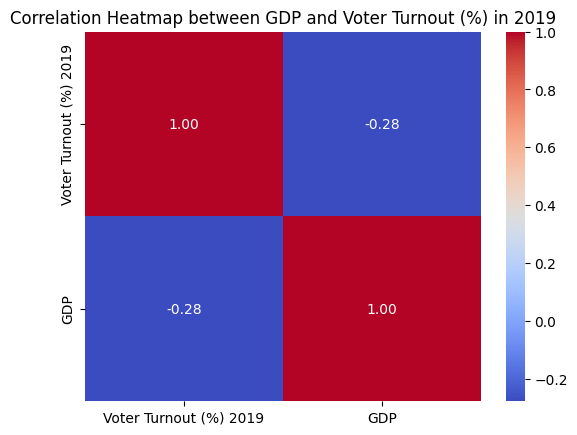

In [110]:
# Defined in question above
correlation_ls_2019

# Importing GDP data
df_gdp = pd.read_csv('GDP.csv')  # Read the GDP data from a CSV file
df_gdp

# Merging the two dataframes
gdp_vto = pd.merge(correlation_ls_2019, df_gdp, on='state')  # Merge the correlation dataframe with the GDP dataframe on the state column

# Plotting the heatmap for correlation between GDP and Voter Turnout (%)
# gdp_vto.plot(kind='scatter', color='blue', x='GDP', y='Voter Turnout (%) 2019')  # This line is commented out, indicating an alternative plot type
sb.heatmap(gdp_vto[['Voter Turnout (%) 2019','GDP']].corr(), annot=True, cmap='coolwarm', fmt=".2f")  # Create a heatmap for the correlation between GDP and Voter Turnout (%)
plt.title('Correlation Heatmap between GDP and Voter Turnout (%) in 2019')  # Set the title for the heatmap
plt.show()  # Display the heatmap


**14. Is there a correlation between literacy % of the state and voter turnout % ?**

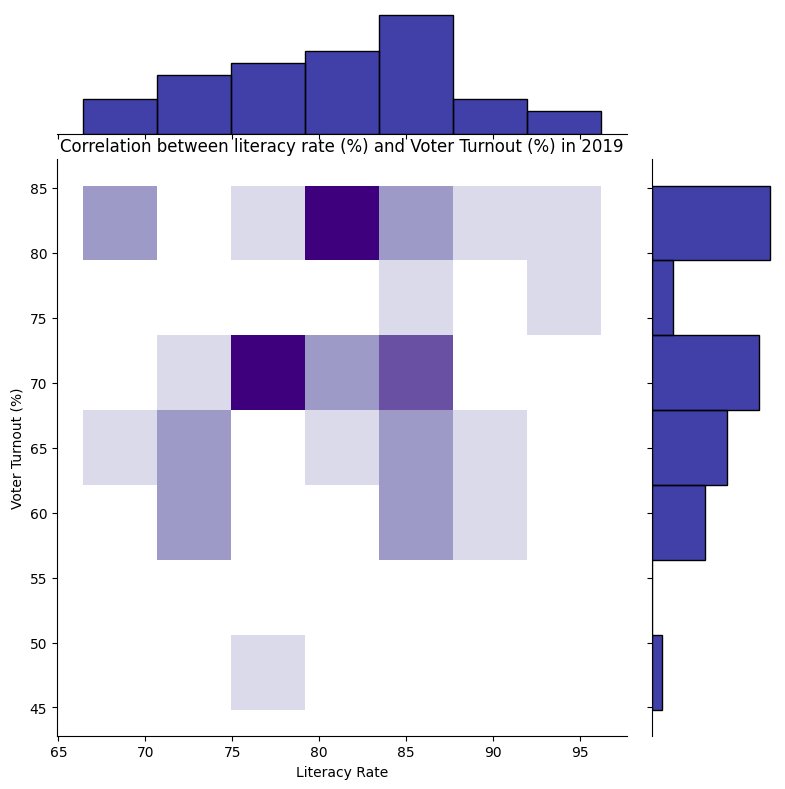

In [112]:
# Defined in question above
correlation_ls_2019

# Importing CSV file containing literacy% by state
df_literacy = pd.read_csv('literacy rate.csv')  # Read the literacy rate data from a CSV file

# Merging the two dataframes
lr_vto = pd.merge(correlation_ls_2019, df_literacy, on='state', how='right')  # Merge the correlation dataframe with the literacy rate dataframe on the state column, using a right join

# Creating a joint plot
# sb.heatmap(lr_vto[['Voter Turnout (%) 2019','literacy_rate']].corr(), annot=True, cmap='coolwarm', fmt=".2f")  # This line is commented out, indicating an alternative plot type
sb.jointplot(data=lr_vto, kind='hist', x='literacy_rate', y='Voter Turnout (%) 2019', height=8, ratio=4, cmap='Purples', color='darkblue')  # Create a joint plot with histograms, plotting literacy rate against voter turnout percentage

# Setting the title and labels
plt.title('Correlation between literacy rate (%) and Voter Turnout (%) in 2019', size=12)  # Set the title for the joint plot
plt.xlabel('Literacy Rate')  # Set the x-axis label
plt.ylabel('Voter Turnout (%)')  # Set the y-axis label

# Display the plot
plt.show()  # Display the joint plot


**15.Candidates ratio based on gender in 2014 and 2019?**

In [ ]:
# Gender count from 2014
male_candidates14 = (df_2014['sex']=='M').sum()  # Count the number of male candidates in 2014
female_candidates14 = (df_2014['sex']=='F').sum()  # Count the number of female candidates in 2014

# Gender count from 2019
male_candidates19 = (df_2019['sex']=='MALE').sum()  # Count the number of male candidates in 2019
female_candidates19 = (df_2019['sex']=='FEMALE').sum()  # Count the number of female candidates in 2019

# Setting up values in lists/arrays
data14 = [male_candidates14, female_candidates14]  # List of male and female candidates in 2014
data19 = [male_candidates19, female_candidates19]  # List of male and female candidates in 2019

labels_mf = ['MALE', 'FEMALE']  # Labels for the pie chart
explodeTuple = (0.1, 0.0)  # Explode the first slice (male) slightly

color14 = ['dodgerblue', 'hotpink']  # Colors for the 2014 pie chart
color19 = ['steelblue', 'deeppink']  # Colors for the 2019 pie chart

# Plotting
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14,6))  # Create subplots with 1 row and 2 columns, set the figure size

# Plotting the 2014 pie chart
axes[0].pie(data14, colors=color14, explode=(0.1, 0.0), labels=labels_mf, autopct='%1.1f%%', pctdistance=0.85, startangle=90, textprops={'color':"w", 'size':12, 'weight':'bold'})  # Create a pie chart for 2014 data
axes[0].set_title('Male vs Female ratio in 2014')  # Set the title for the 2014 pie chart
axes[0].legend(labels_mf, title="Gender", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))  # Add a legend for the 2014 pie chart

# Plotting the 2019 pie chart
axes[1].pie(data19, colors=color19, explode=(0.1, 0.0), labels=labels_mf, autopct='%1.1f%%', pctdistance=0.85, startangle=90, textprops={'color':"w", 'size':12, 'weight':'bold'})  # Create a pie chart for 2019 data
axes[1].set_title('Male vs Female ratio in 2019')  # Set the title for the 2019 pie chart
axes[1].legend(labels_mf, title="Gender", loc="center left", bbox_to_anchor=(1, 0, 0.5, 1))  # Add a legend for the 2019 pie chart

# Display the plots
plt.show()  # Display the pie charts
